In [ ]:
import os
import itertools
import PIL
from tqdm import tqdm
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision 
import torch.optim as optim
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms
from torch.utils.data import Dataset
from torchvision import transforms
from torch.utils.data import DataLoader

In [ ]:
dir_path = '/content/drive/MyDrive/Colab Notebooks/Zero-DCE'
data_path = os.path.join(dir_path, 'datasets/lol_dataset/our485/low')
batch_size = 8

In [ ]:
!nvidia-smi

NVIDIA-SMI has failed because it couldn't communicate with the NVIDIA driver. Make sure that the latest NVIDIA driver is installed and running.



In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Dataset

In [ ]:
def plotImage(image):
  image = np.array(image)
  plt.imshow(np.transpose(image,(1,2,0)))

In [ ]:
def normalizeImage(image):
  mean = (0,0,0)
  std = (1,1,1)
  brightness, contrast, saturation, hue = 0.25*np.random.random_sample((4,))
  transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.ColorJitter(brightness= brightness, contrast=contrast, saturation=saturation, hue=hue),
    transforms.Normalize(mean, std)])
  return transform(image)

In [ ]:
def plotGrid(images):
  img_grid = torchvision.utils.make_grid(images, nrow=4)
  img_grig = np.array(img_grid)
  img_grid = np.transpose(img_grid,(1,2,0))
  plt.imshow(img_grid)

In [ ]:
class LOL(Dataset):
    def __init__(self, img_dir):
        self.img_dir = img_dir
        self.img_list = os.listdir(img_dir)

    def __len__(self):
        return len(self.img_list)

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.img_list[idx])
        image = Image.open(img_path)
        image = image.resize((256, 256))
        image = np.array(image)/255
        #image = normalizeImage(image) 
        # do not apply transpose if applying normalization
        image = np.transpose(image,(2,0,1))
        image = torch.tensor(image, dtype=torch.float32, requires_grad=False)
        return image

In [ ]:
train_dataset = LOL(img_dir=data_path) #dataset
train_dataloader = DataLoader(train_dataset, batch_size, shuffle=True, num_workers=2)

In [ ]:
images = next(iter(train_dataloader))
print(f"Feature batch shape: {images.size()}")

Feature batch shape: torch.Size([8, 3, 256, 256])


torch.Size([8, 3, 256, 256])


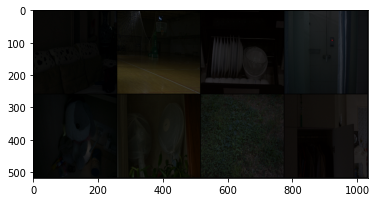

In [ ]:
print(images.size())
plotGrid(images)

## Model
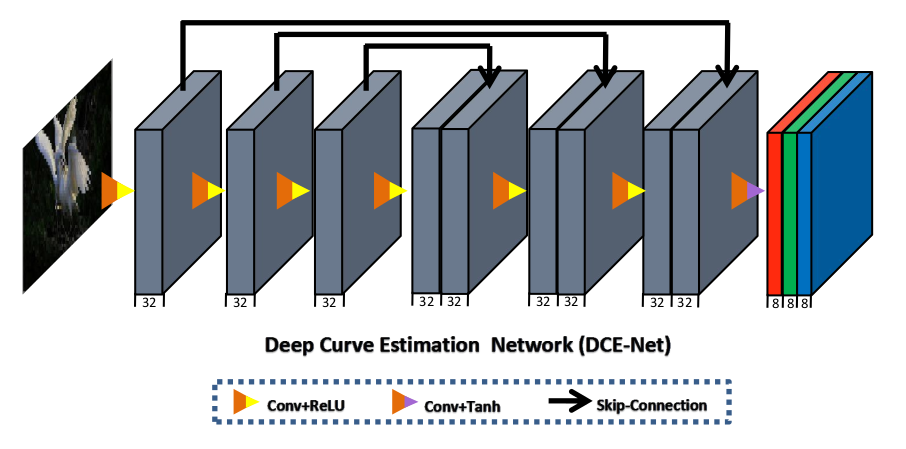

In [ ]:
class ConvBlock(nn.Module):
  """ Convolution block for DCE-net"""
  def __init__(self, in_channels, out_channels):
    super(ConvBlock, self).__init__()
    self.conv = nn.Sequential(
        nn.Conv2d(in_channels, out_channels, kernel_size=3, padding= 'same', bias=False),
        nn.ReLU(inplace=True))
    
  def forward(self, x):
    return self.conv(x)

In [ ]:
class outConv(nn.Module):
  """ Convolution block for model output """
  def __init__(self, in_channels, out_channels):
    super(outConv, self).__init__()
    self.conv = nn.Sequential(
        nn.Conv2d(in_channels, out_channels, kernel_size=3, padding= 'same', bias=False),
        nn.Tanh(),)
    
  def forward(self, x):
    return self.conv(x)

In [ ]:
class DCEnet(nn.Module):
  def __init__(self, in_channels=3, out_channels=24):
    super(DCEnet, self).__init__()
    self.conv1 = ConvBlock(in_channels = 3, out_channels = 32)
    self.conv2 = ConvBlock(in_channels = 32, out_channels = 32)
    self.conv3 = ConvBlock(in_channels = 32, out_channels = 32)
    self.conv4 = ConvBlock(in_channels = 32, out_channels = 32)
    self.conv5 = ConvBlock(in_channels = 64, out_channels = 32)
    self.conv6 = ConvBlock(in_channels = 64, out_channels = 32)
    self.conv7 = outConv(in_channels = 64, out_channels = 24)

  def weights_init(self):
    for param in self.parameters():
      torch.nn.init.normal_(param, mean=0.0, std=0.02)
      
  def forward(self, x):
    x1 = self.conv1(x)
    x2 = self.conv2(x1)
    x3 = self.conv3(x2)

    x4 = self.conv4(x3)
    x4 = torch.cat((x4, x3), dim=1)
    
    x5 = self.conv5(x4)
    x5 = torch.cat((x5, x2), dim=1)

    x6 = self.conv6(x5)
    x6 = torch.cat((x6, x1), dim=1)

    A = self.conv7(x6)

    a1, a2, a3, a4, a5, a6, a7, a8 = torch.split(A, 3, dim=1)
    e1 = x + a1*(x - torch.pow(x,2))
    e1 = e1 + a2*(e1 - torch.pow(e1,2))
    e1 = e1 + a3*(e1 - torch.pow(e1,2))
    e1 = e1 + a4*(e1 - torch.pow(e1,2))
    e2 = e1 + a5*(e1 - torch.pow(e1,2))
    e2 = e2 + a6*(e2 - torch.pow(e2,2))
    e2 = e2 + a7*(e2 - torch.pow(e2,2))
    e2 = e2 + a8*(e2 - torch.pow(e2,2))
    return (A, e2)

In [ ]:
zerodce = DCEnet()
zerodce.weights_init()
zerodce = zerodce.to(device)

## Tensorboard

In [ ]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter('runs/exp_1')

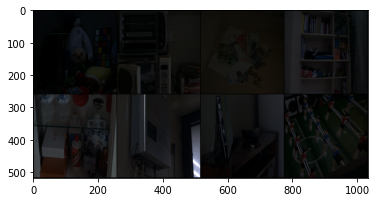

In [ ]:
images = next(iter(train_dataloader))
plotGrid(images)

In [ ]:
img_grid = torchvision.utils.make_grid(images, nrow=4)
writer.add_image('images', img_grid)

In [ ]:
writer.add_graph(zerodce, images.to(device))

In [ ]:
%load_ext tensorboard
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

## Loss

In [ ]:
class L_spa(nn.Module):
  """ Spatial consitency loss for spatial coherence """ 
  def __init__(self):
    super(L_spa, self).__init__()
    left = torch.FloatTensor( [[0,0,0],[-1,1,0],[0,0,0]]).unsqueeze(0).unsqueeze(0).to(device)
    right = torch.FloatTensor( [[0,0,0],[0,1,-1],[0,0,0]]).unsqueeze(0).unsqueeze(0).to(device)
    up = torch.FloatTensor( [[0,-1,0],[0,1, 0 ],[0,0,0]]).unsqueeze(0).unsqueeze(0).to(device)
    down = torch.FloatTensor( [[0,0,0],[0,1, 0],[0,-1,0]]).unsqueeze(0).unsqueeze(0).to(device)

    self.weight_left = nn.Parameter(data=left, requires_grad=False)
    self.weight_right = nn.Parameter(data=right, requires_grad=False)
    self.weight_up = nn.Parameter(data=up, requires_grad=False)
    self.weight_down = nn.Parameter(data=down, requires_grad=False)
    self.pool = nn.AvgPool2d(4)

  def forward(self, input, enhanced):
    input_pooled = self.pool(torch.mean(input, dim=1, keepdim=True))
    enhanced_pooled = self.pool(torch.mean(enhanced, dim=1, keepdim=True))

    input_left = F.conv2d(input_pooled , self.weight_left, padding=1)
    input_right = F.conv2d(input_pooled , self.weight_right, padding=1)
    input_up = F.conv2d(input_pooled , self.weight_up, padding=1)
    input_down = F.conv2d(input_pooled , self.weight_down, padding=1)

    enhanced_left = F.conv2d(enhanced_pooled , self.weight_left, padding=1)
    enhanced_right = F.conv2d(enhanced_pooled , self.weight_right, padding=1)
    enhanced_up = F.conv2d(enhanced_pooled , self.weight_up, padding=1)
    enhanced_down = F.conv2d(enhanced_pooled , self.weight_down, padding=1)

    loss = torch.pow(input_left - enhanced_left, 2) + torch.pow(input_right - enhanced_right, 2) 
    + torch.pow(input_up - enhanced_up, 2) + torch.pow(input_down - enhanced_down, 2)

    return torch.mean(loss)

In [ ]:
class L_exp(nn.Module):
  """ Exposure control loss """
  def __init__(self):
    super(L_exp, self).__init__()
    self.pool = nn.AvgPool2d(16)

  def forward(self, input, E=0.6):
    pooled_input = self.pool(torch.mean(input, dim=1, keepdim = True))
    loss = torch.mean(torch.pow(pooled_input-E, 2))
    return loss

In [ ]:
class L_ccl(nn.Module):
  """ Colour constancy loss"""
  def __init__(self):
    super(L_ccl, self).__init__()

  def forward(self, enhanced):
    mean_rgb = torch.mean(enhanced, [2,3], keepdim=True)
    mean_r, mean_g, mean_b = torch.split(mean_rgb, 1, dim=1)
    loss = torch.sqrt(torch.pow(mean_r-mean_g, 4) + torch.pow(mean_b-mean_g, 4) + torch.pow(mean_r-mean_b, 4))
    return loss

In [ ]:
class L_tvA(nn.Module):
  """ Illumination Smoothness loss """
  def __init__(self):
    super(L_tvA, self).__init__()

  def forward(self, A):
    b,c,h,w = A.size()
    LtvA = torch.pow(torch.mean(torch.sum(torch.pow(A[:, :, :h-1, :] - A[:, :, 1:, :], 2), dim=1))+
                     torch.mean(torch.sum(torch.pow(A[:, :, :, :w-1] - A[:, :, :, 1:], 2), dim=1)), 2)
    return LtvA

In [ ]:
class TotalLoss(nn.Module):
  def __init__(self):
    super(TotalLoss, self).__init__()
    self.ltva = L_tvA()
    self.lccl = L_ccl()
    self.lexp = L_exp()
    self.lspa = L_spa()
  
  def forward(self, input, enhanced, A):
    Wtva, Wcol, Wexp = 200, 5, 10
    sc_loss = torch.mean(self.lspa(input, enhanced))
    cc_loss = torch.mean(self.lccl(enhanced))
    ec_loss = torch.mean(self.lexp(enhanced))
    is_loss = torch.mean(self.ltva(A))
    loss = sc_loss + Wcol*cc_loss + Wexp*ec_loss + Wtva*is_loss
    return sc_loss, ec_loss, cc_loss, is_loss, loss

## Training

In [ ]:
PATH = os.path.join(dir_path, 'checkpoints')
lossfunction = TotalLoss()

In [ ]:
checkpoint = torch.load(os.path.join(PATH, 'model.pth'), map_location = device)
zerodce.load_state_dict(checkpoint['DCEnet_state_dict'])

<All keys matched successfully>

In [ ]:
lr = 0.0001
optimizer = torch.optim.Adam(zerodce.parameters(), lr= lr)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.8, patience=3, min_lr=0.00001, eps=1e-08, verbose=True)

In [ ]:
def add_images_to_tensorboard(epoch):
  images = next(iter(train_dataloader)).to(device)
  A, e2 = zerodce(images)
  e2.to(torch.device('cpu'))

  img_grid = torchvision.utils.make_grid(images.to(torch.device('cpu')), nrow=4)
  writer.add_image('image at epoch -> '+str(epoch), img_grid)

  img_grid = torchvision.utils.make_grid(e2, nrow=4)
  writer.add_image('enhanced image at epoch -> '+str(epoch), img_grid)

In [ ]:
def train_one_epoch(epoch, zerodce, lossfunction, running_loss):
  for iteration, images in enumerate(train_dataloader):
    optimizer.zero_grad()
    images = images.to(device)
    A, enhanced_images = zerodce(images)
    sc_loss, ec_loss, cc_loss, is_loss, loss = lossfunction(input = images, enhanced = enhanced_images, A=A)
    loss.backward(retain_graph=False, create_graph=False)

    writer.add_scalar("Loss", loss, iteration) #add loss to tensorboard
    writer.add_scalar("Spatial constancy Loss", sc_loss, iteration)
    writer.add_scalar("Exposure control Loss", ec_loss, iteration) 
    writer.add_scalar("Colour constancy Loss", cc_loss, iteration) 
    writer.add_scalar("illumination smoothness Loss", is_loss, iteration) 

    running_loss = running_loss*0.9 + loss.item()
    # nn.utils.clip_grad_norm_(zerodce.parameters(), max_norm=0.01, norm_type=2.0)
    optimizer.step() #update weights
  return running_loss

In [ ]:
def train(num_epochs = 20):
  running_loss = 0
  for epoch in tqdm(range(num_epochs)):
    add_images_to_tensorboard(epoch)
    running_loss = train_one_epoch(epoch = epoch, zerodce = zerodce, lossfunction = lossfunction, running_loss = running_loss)
    torch.save({'DCEnet_state_dict': zerodce.state_dict()}, os.path.join(PATH, 'model.pth'))
    torch.cuda.empty_cache()

In [ ]:
train()

100%|██████████| 20/20 [09:51<00:00, 29.59s/it]


## Evaluation

In [ ]:
test_data_path = os.path.join(dir_path, 'datasets/lol_dataset/eval15/low')

In [ ]:
test_dataset = LOL(img_dir=test_data_path) #dataset
test_dataloader = DataLoader(test_dataset, 1, shuffle=True, num_workers=2)

In [ ]:
enhanced_images = []
images = []
with torch.no_grad():
  for image in test_dataloader:
    _, enhanced_image = zerodce(image)
    enhanced_images.append(enhanced_image)
    images.append(image)
enhanced_images = torch.stack(enhanced_images)
images = torch.stack(images)

In [ ]:
enhanced_images = torch.squeeze(enhanced_images, dim=1)
images = torch.squeeze(images, dim=1)
print(enhanced_images.size())

torch.Size([15, 3, 256, 256])


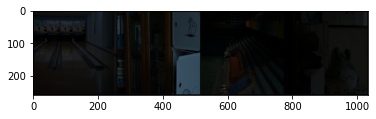

In [ ]:
plotGrid(images[0:4])

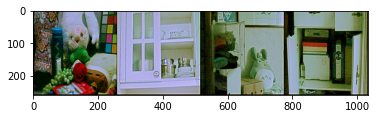

In [ ]:
plotGrid(enhanced_images[0:4])

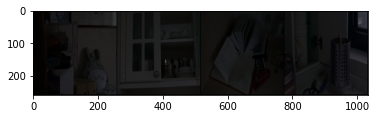

In [ ]:
plotGrid(images[4:8])

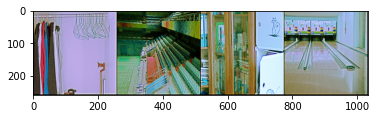

In [ ]:
plotGrid(enhanced_images[4:8])

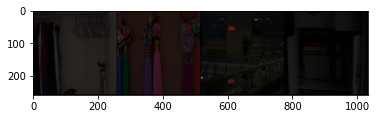

In [ ]:
plotGrid(images[8:12])

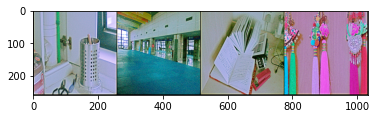

In [ ]:
plotGrid(enhanced_images[8:12])